# Making fits files for the VO




We make the VO images for the GAMA-09 and GAMA-12 fields. The notebook could easily be used to run over all fields. The VO expects one fits file per image layer with just two header key words

In [117]:
from datetime import datetime
from itertools import product

import numpy as np
import os
import glob

from astropy.io import fits
from astropy.table import Table
from astropy.wcs import WCS

import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm





In [127]:
help_maps=glob.glob('./data/*_v1.0.fits')

In [74]:
!mkdir -p ./data/vo/png

In [90]:
for n in np.arange(len(fits.open('./data/GAMA-12_SPIRE500_v1.0.fits'))):
    try:
        print(n,fits.open('./data/GAMA-12_SPIRE500_v1.0.fits')[n].header['EXTNAME'])
    except:
        pass

1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
5 MASK
6 MFILT
7 MFILT_ERROR
8 Matchedfilter


In [128]:
#Make the VO simple layer fits files
for file in help_maps:
    hdu_list = fits.open(file)
    wave=file.split('_')[1].strip('SPIRE')
    field=file.split('/')[-1].split('_')[0]
    this_wcs=None
    if True:
        for layer in [1,2,3,4]:
#for field in ['Herschel-Stripe-82']: #['GAMA-09','GAMA-12','Herschel-Stripe-82']:
#    for wave in [250]: #[250,350,500]:

#        hdu_list = fits.open('./data/{}_SPIRE{}_v1.0.fits'.format(field,wave))
#        for layer in [1,3,4]:

            hdu = hdu_list[layer]
            primary_hdu=fits.PrimaryHDU(hdu.data)
            primary_hdu.header=hdu.header
            primary_hdu.header.update(WCS(hdu_list[1].header).to_header())
            #new_hdu=fits.ImageHDU(hdu.data)
            #new_hdu.header=hdu.header
            print(layer, hdu.header['EXTNAME'])
            primary_hdu.header['HFIELD']=field
            #if hdu.header['EXTNAME'].startswith('NEBFILT'):
            #    hdu.header['EXTNAME']='IMAGE'
            primary_hdu.header['HTYPE']=hdu.header['EXTNAME'].lower()
            primary_hdu.header['HBAND']   = 'SPIRE{}'.format(wave)                                                            
            primary_hdu.header['HTITLE']  = '{} SPIRE{} ({})'.format(field,wave,hdu.header['EXTNAME'].lower())
            primary_hdu.header['INSTRUME']= 'SPIRE   '  
            primary_hdu_list = fits.HDUList([primary_hdu])
            primary_hdu_list.verify('fix') 
            primary_hdu_list.writeto('./data/vo/{}_{}_{}_VOX.fits'.format(
                field,hdu.header['EXTNAME'].lower(),wave),checksum=True,overwrite=True)



1 IMAGE


 [astropy.io.fits.verify]


2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE
1 IMAGE
2 NEBFILT
3 ERROR
4 EXPOSURE


In [93]:
new_fits = glob.glob('./data/vo/*.fits')

In [94]:
new_fits

['./data/vo/Herschel-Stripe-82_image_250_VOX.fits',
 './data/vo/Herschel-Stripe-82_nebfilt_500_VOX.fits',
 './data/vo/GAMA-12_exposure_500_VOX.fits',
 './data/vo/GAMA-09_error_500_VOX.fits',
 './data/vo/GAMA-09_nebfilt_500_VOX.fits',
 './data/vo/GAMA-12_image_250_VOX.fits',
 './data/vo/GAMA-09_nebfilt_350_VOX.fits',
 './data/vo/GAMA-09_error_350_VOX.fits',
 './data/vo/GAMA-12_exposure_350_VOX.fits',
 './data/vo/Herschel-Stripe-82_nebfilt_350_VOX.fits',
 './data/vo/Herschel-Stripe-82_error_500_VOX.fits',
 './data/vo/Herschel-Stripe-82_exposure_250_VOX.fits',
 './data/vo/GAMA-12_nebfilt_250_VOX.fits',
 './data/vo/GAMA-12_error_350_VOX.fits',
 './data/vo/GAMA-09_image_250_VOX.fits',
 './data/vo/GAMA-09_exposure_250_VOX.fits',
 './data/vo/GAMA-12_error_500_VOX.fits',
 './data/vo/Herschel-Stripe-82_error_350_VOX.fits',
 './data/vo/GAMA-12_image_350_VOX.fits',
 './data/vo/GAMA-09_nebfilt_250_VOX.fits',
 './data/vo/GAMA-12_exposure_250_VOX.fits',
 './data/vo/GAMA-09_error_250_VOX.fits',
 './d

/Users/raphaelshirley/miniconda3/envs/herschelhelp_internal/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


OSError: Empty or corrupt FITS file

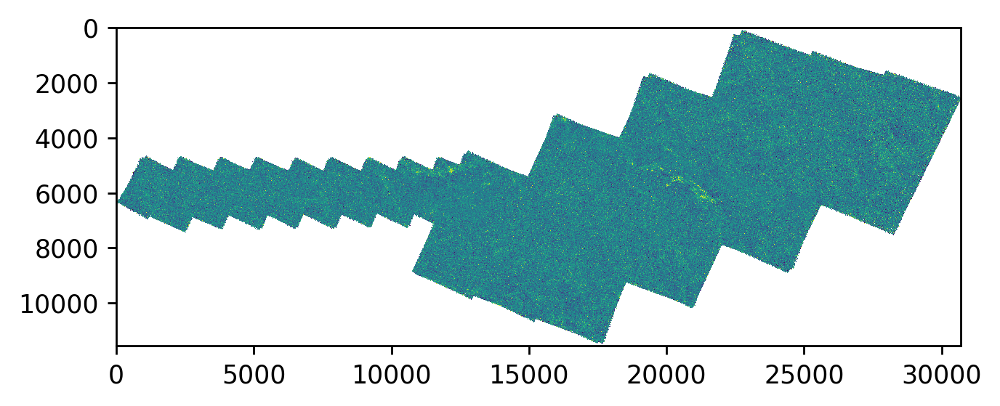

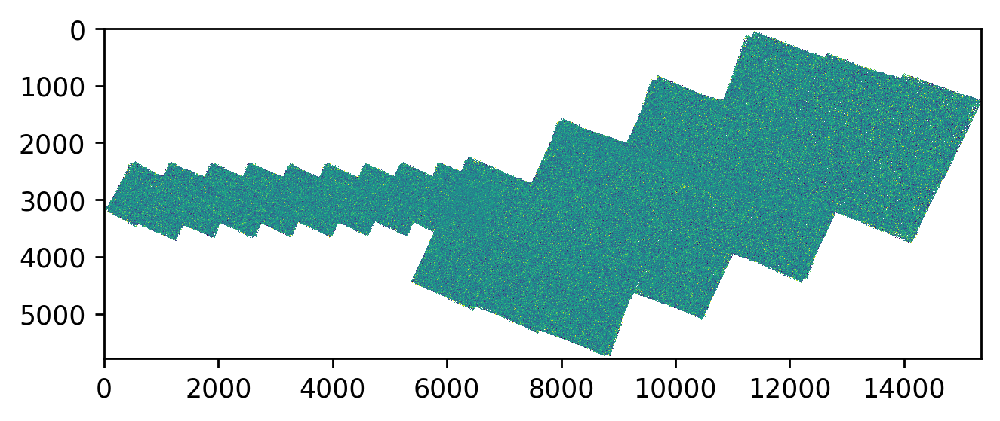

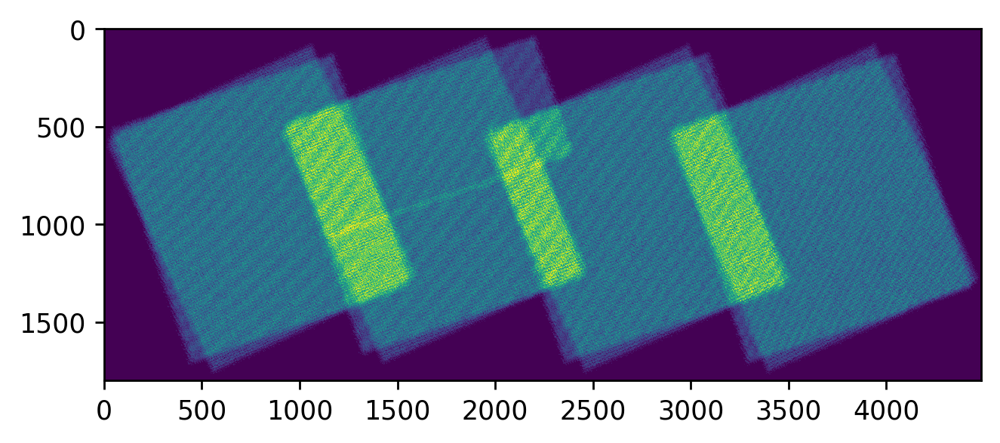

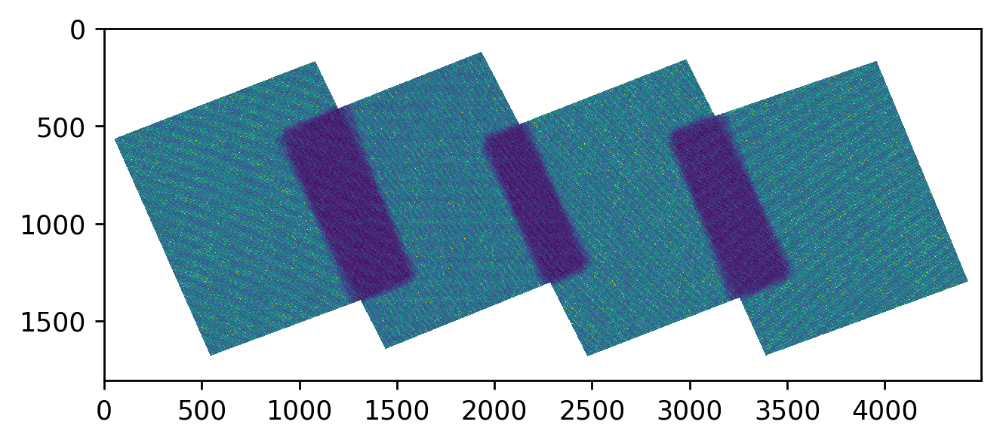

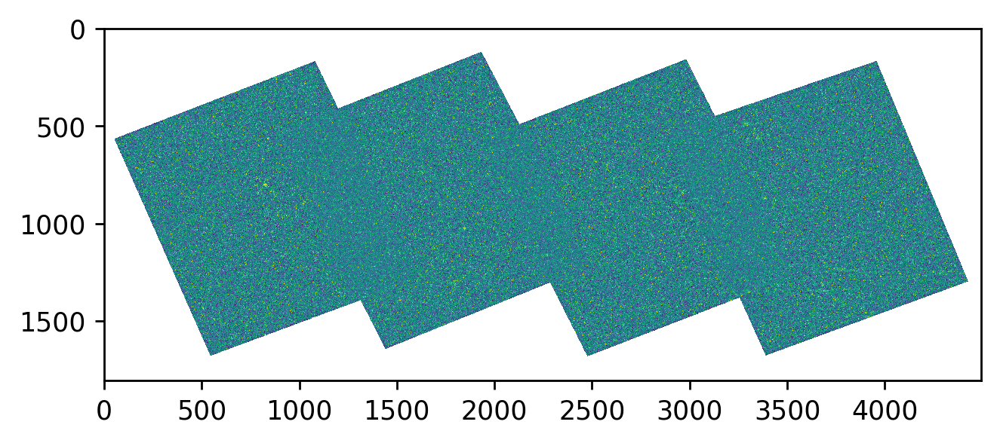

...

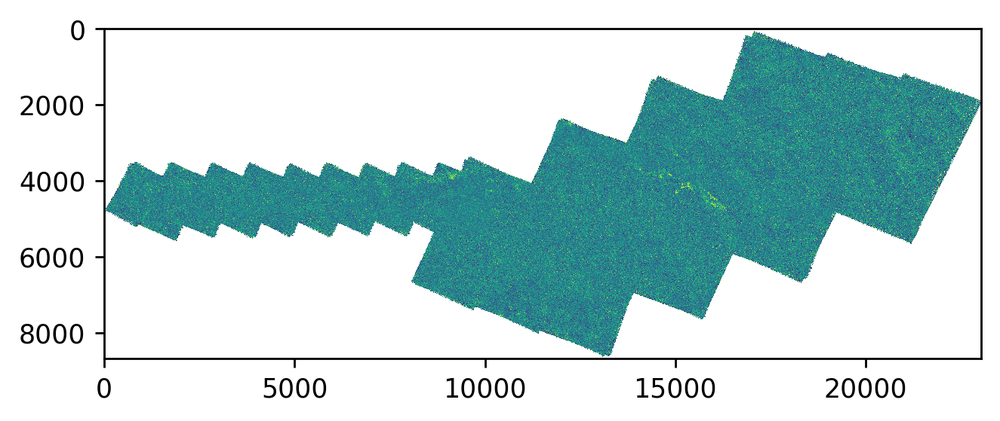

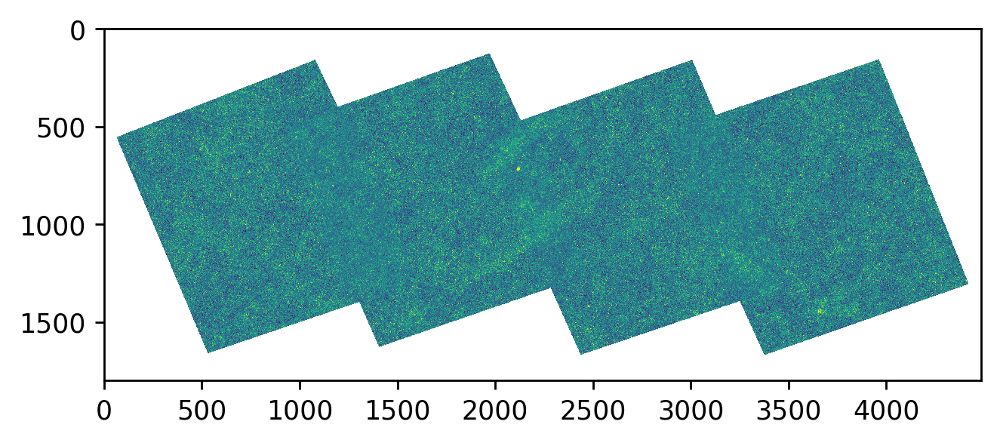

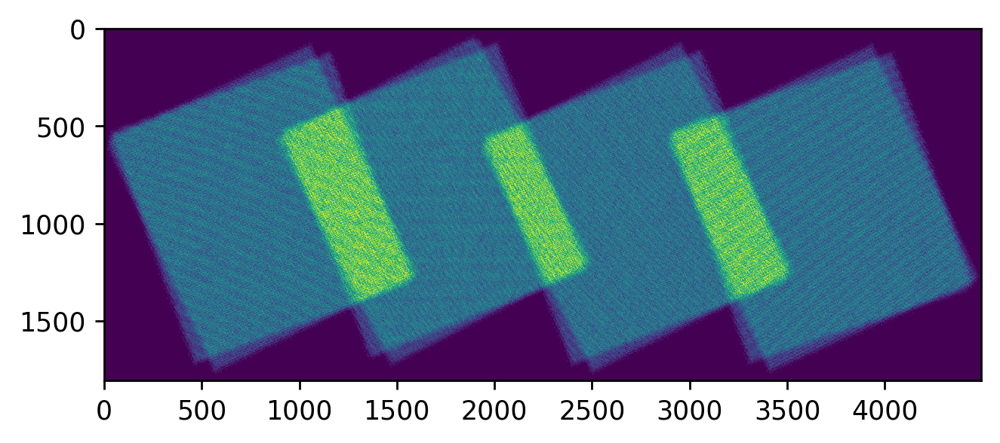

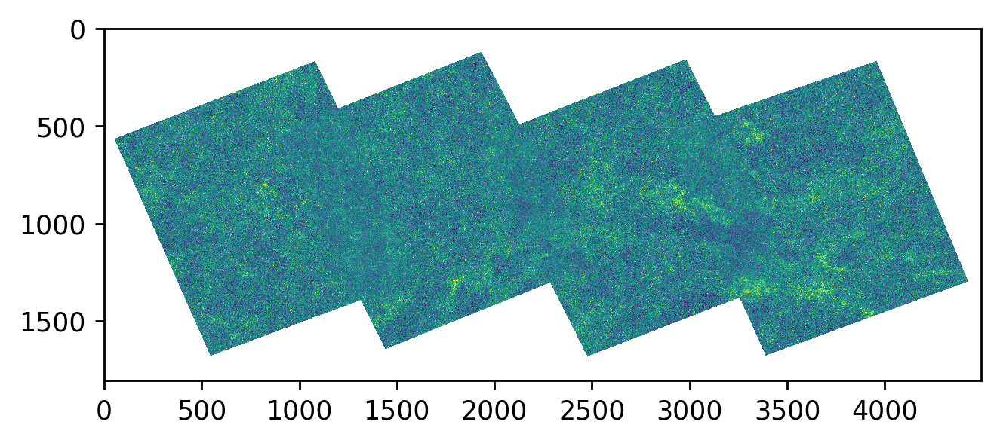

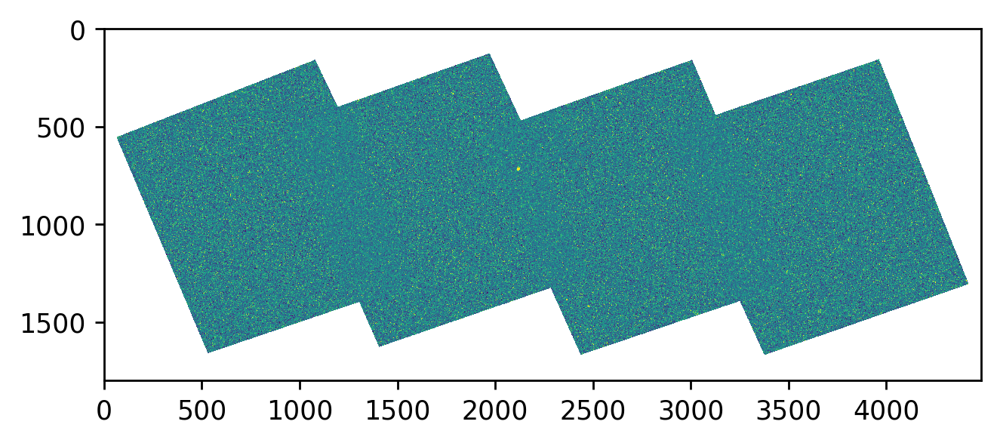

<Figure size 1500x1000 with 0 Axes>

In [114]:
#png previews
for f in new_fits:
    fig = plt.figure(dpi=250)
    try:
        im_data=fits.getdata(f)
        im = plt.imshow(
            im_data, 
            clim=(
            np.nanpercentile(im_data.ravel(),0.1), 
            np.nanpercentile(im_data.ravel(),99.9)
            )
        )
        plt.savefig('./data/vo/png/{}.png'.format(f.split('/')[-1]))
    except:
        print('Failed: ',f)

## Show headers

Here are a few representative headers

In [63]:
fits.open('./data/vo/{}_{}_{}_VOX.fits'.format('Herschel-Stripe-82','image','250'))

[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x7fe0d8e83160>, <astropy.io.fits.hdu.image.ImageHDU object at 0x7fe0d8e5a7f0>]

In [65]:
fits.open('./data/vo/{}_{}_{}_VOX.fits'.format('Herschel-Stripe-82','image','250'))[0].header

SIMPLE  =                    T                                                  
BITPIX  =                  -64 / bits per data value                            
NAXIS   =                    2 / number of axes                                 
NAXIS1  =                30706 / size of the n'th axis                          
NAXIS2  =                11550 / size of the n'th axis                          
XTENSION= 'IMAGE   '           / marks beginning of new HDU                     
PCOUNT  =                    0 / Required value                                 
GCOUNT  =                    1 / Required value                                 
LONGSTRN= 'OGIP 1.0'           / The OGIP long string convention may be used.   
COMMENT This FITS file may contain long string keyword values that are          
COMMENT continued over multiple keywords.  This convention uses the  '&'        
COMMENT character at the end of a string which is then continued                
COMMENT on subsequent keywor

In [54]:
fits.open('./data/{}_SPIRE{}_v1.0.fits'.format('Herschel-Stripe-82','250'))[1].header

XTENSION= 'IMAGE   '           / marks beginning of new HDU                     
BITPIX  =                  -64 / bits per data value                            
NAXIS   =                    2 / number of axes                                 
NAXIS1  =                30706 / size of the n'th axis                          
NAXIS2  =                11550 / size of the n'th axis                          
PCOUNT  =                    0 / Required value                                 
GCOUNT  =                    1 / Required value                                 
LONGSTRN= 'OGIP 1.0'           / The OGIP long string convention may be used.   
COMMENT This FITS file may contain long string keyword values that are          
COMMENT continued over multiple keywords.  This convention uses the  '&'        
COMMENT character at the end of a string which is then continued                
COMMENT on subsequent keywords whose name = 'CONTINUE'.                         
         -------------- Hers

In [11]:
g12=fits.open('./data/GAMA-12_SPIRE250_v1.0.fits')

In [12]:
g12[1].header

XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                  -32 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
NAXIS1  =                 8974                                                  
NAXIS2  =                 3594                                                  
PCOUNT  =                    0 / number of parameters                           
GCOUNT  =                    1 / number of groups                               
CTYPE1  = 'RA---TAN'                                                            
CTYPE2  = 'DEC--TAN'                                                            
CRVAL1  = 181.5354636915630522 /                                                
CDELT1  =          -0.00166667                                                  
CRPIX1  =               3374.5                                                  
CRVAL2  =  -0.57355253289350

In [16]:
hs250=fits.open('./data/Stripe82-PSWmap-mosaic_MS-20200221.fits')

In [25]:
hs250[3].header

XTENSION= 'IMAGE   '           / marks beginning of new HDU                     
BITPIX  =                  -64 / bits per data value                            
NAXIS   =                    2 / number of axes                                 
NAXIS1  =                30706 / size of the n'th axis                          
NAXIS2  =                11550 / size of the n'th axis                          
PCOUNT  =                    0 / Required value                                 
GCOUNT  =                    1 / Required value                                 
LONGSTRN= 'OGIP 1.0'           / The OGIP long string convention may be used.   
COMMENT This FITS file may contain long string keyword values that are          
COMMENT continued over multiple keywords.  This convention uses the  '&'        
COMMENT character at the end of a string which is then continued                
COMMENT on subsequent keywords whose name = 'CONTINUE'.                         
         -------------- Hers